<a href="https://colab.research.google.com/github/Gedeon-m-gedus/Image_Processing/blob/master/CV_19_CHANGES_DETECTION.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
# Mounting the google drive
from google.colab import drive
drive.mount('/content/gdrive')#
#root_path = 'gdrive/My Drive/AMMI_project/object_detector'

In [ ]:
# unzipping the data into the dataset folder
!unzip -q /content/gdrive/My\ Drive/AMMI_project/GEOFFREY/DATA.zip -d dataset/

In [ ]:
!pip install -U torch==1.5 torchvision==0.6 -f https://download.pytorch.org/whl/cu101/torch_stable.html >/dev/null
!pip install cython pyyaml==5.1 >/dev/null
!pip install -U 'git+https://github.com/cocodataset/cocoapi.git#subdirectory=PythonAPI' >/dev/null
import torch, torchvision
print(torch.__version__, torch.cuda.is_available())
!gcc --version

# install detectron2:
!pip install detectron2==0.1.2 -f https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/index.html >/dev/null

# Setup detectron2 logger
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import os
import random
import time
import matplotlib.pyplot as plt
import numpy as np
import cv2
from google.colab.patches import cv2_imshow

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog
from detectron2.engine import DefaultTrainer
from detectron2.config import get_cfg
from detectron2.utils.visualizer import ColorMode
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader
#from detectron2.data.datasets import register_pascal_voc

  Running command git clone -q https://github.com/cocodataset/cocoapi.git /tmp/pip-req-build-_6uxkh_7
1.5.0+cu101 True
gcc (Ubuntu 7.5.0-3ubuntu1~18.04) 7.5.0
Copyright (C) 2017 Free Software Foundation, Inc.
This is free software; see the source for copying conditions.  There is NO
warranty; not even for MERCHANTABILITY or FITNESS FOR A PARTICULAR PURPOSE.



In [ ]:
import numpy as np
import os
import xml.etree.ElementTree as ET
from typing import List, Tuple, Union
from fvcore.common.file_io import PathManager

from detectron2.data import DatasetCatalog, MetadataCatalog
from detectron2.structures import BoxMode

In [ ]:
# fmt: off
CLASS_NAMES = ('house',
              'round_about',
              'parking',
              'vegetation',
              'neighborhood')

def load_voc_instances(dirname: str, split: str, class_names: Union[List[str], Tuple[str, ...]]):
    """
    Load Pascal VOC detection annotations to Detectron2 format.
    Args:
        dirname: Contain "Annotations", "ImageSets", "JPEGImages"
        split (str): one of "train", "test", "val", "trainval"
        class_names: list or tuple of class names
    """
    with PathManager.open(os.path.join(dirname, split + ".txt")) as f:
        fileids = np.loadtxt(f, dtype=np.str)

    # Needs to read many small annotation files. Makes sense at local
    annotation_dirname = PathManager.get_local_path(os.path.join(dirname, "annotations/"))
    dicts = []
    for fileid in fileids:
        anno_file = os.path.join(annotation_dirname, fileid + ".xml")
        jpeg_file = os.path.join(dirname, "IMAGES/", fileid + ".jpg")

        with PathManager.open(anno_file) as f:
            tree = ET.parse(f)

        r = {
            "file_name": jpeg_file,
            "image_id": fileid,
            "height": int(tree.findall("./size/height")[0].text),
            "width": int(tree.findall("./size/width")[0].text),
        }
        instances = []

        for obj in tree.findall("object"):
            cls = obj.find("name").text
            # We include "difficult" samples in training.
            # Based on limited experiments, they don't hurt accuracy.
            # difficult = int(obj.find("difficult").text)
            # if difficult == 1:
            # continue
            bbox = obj.find("bndbox")
            bbox = [float(bbox.find(x).text) for x in ["xmin", "ymin", "xmax", "ymax"]]
            # Original annotations are integers in the range [1, W or H]
            # Assuming they mean 1-based pixel indices (inclusive),
            # a box with annotation (xmin=1, xmax=W) covers the whole image.
            # In coordinate space this is represented by (xmin=0, xmax=W)
            bbox[0] -= 1.0
            bbox[1] -= 1.0
            instances.append(
                {"category_id": class_names.index(cls), "bbox": bbox, "bbox_mode": BoxMode.XYXY_ABS}
            )
        r["annotations"] = instances
        dicts.append(r)
    return dicts


def register_pascal_voc(name, dirname, split, year, class_names=CLASS_NAMES):
    meta_data = DatasetCatalog.register(name, lambda: load_voc_instances(dirname, split, class_names))
    catalog = MetadataCatalog.get(name).set(
        thing_classes=list(class_names), dirname=dirname, year=year, split=split
    )
    #return meta_data, catalog

In [ ]:
name = 'mydata'
dirname = './dataset/DATA/'

In [ ]:
#train_meta_data, train_catalog = 
register_pascal_voc('train_data', dirname, split = 'train', year='2020', class_names=CLASS_NAMES)
train_dataset_dicts = DatasetCatalog.get('train_data')
train_metadata=MetadataCatalog.get('train_data')
register_pascal_voc('valid_data', dirname, split = 'valid', year='2020', class_names=CLASS_NAMES)
valid_dataset_dicts = DatasetCatalog.get('valid_data')
valid_metadata=MetadataCatalog.get('valid_data')

In [ ]:
train_dataset_dicts[0]

{'annotations': [{'bbox': [129.0, 330.0, 417.0, 469.0],
   'bbox_mode': <BoxMode.XYXY_ABS: 0>,
   'category_id': 0},
  {'bbox': [70.0, 410.0, 131.0, 466.0],
   'bbox_mode': <BoxMode.XYXY_ABS: 0>,
   'category_id': 0},
  {'bbox': [700.0, 336.0, 813.0, 389.0],
   'bbox_mode': <BoxMode.XYXY_ABS: 0>,
   'category_id': 0},
  {'bbox': [603.0, 365.0, 717.0, 426.0],
   'bbox_mode': <BoxMode.XYXY_ABS: 0>,
   'category_id': 0},
  {'bbox': [708.0, 428.0, 829.0, 483.0],
   'bbox_mode': <BoxMode.XYXY_ABS: 0>,
   'category_id': 0},
  {'bbox': [605.0, 465.0, 733.0, 525.0],
   'bbox_mode': <BoxMode.XYXY_ABS: 0>,
   'category_id': 0},
  {'bbox': [557.0, 303.0, 822.0, 364.0],
   'bbox_mode': <BoxMode.XYXY_ABS: 0>,
   'category_id': 2},
  {'bbox': [503.0, 330.0, 605.0, 421.0],
   'bbox_mode': <BoxMode.XYXY_ABS: 0>,
   'category_id': 2},
  {'bbox': [505.0, 425.0, 719.0, 467.0],
   'bbox_mode': <BoxMode.XYXY_ABS: 0>,
   'category_id': 2},
  {'bbox': [714.0, 383.0, 823.0, 429.0],
   'bbox_mode': <BoxMode.XY

visualizing  ./dataset/DATA/IMAGES/7-7-2010.jpg


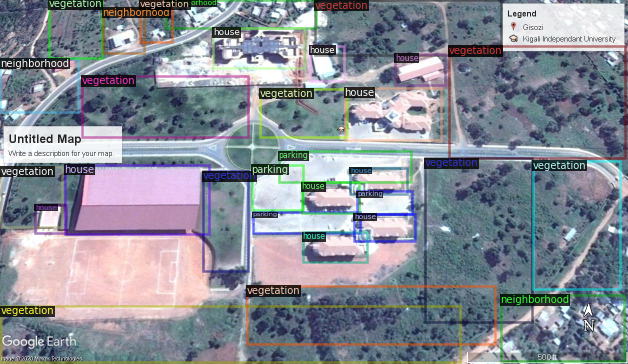

visualizing  ./dataset/DATA/IMAGES/6-21-2011.jpg


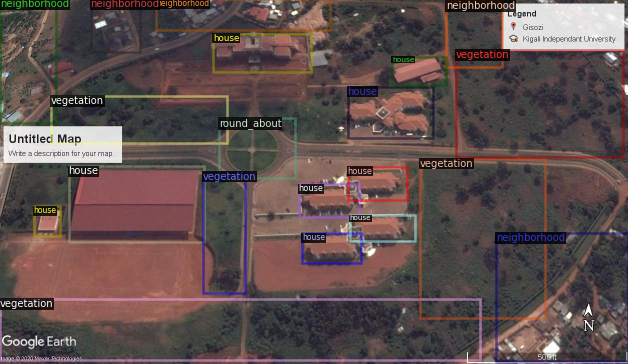

visualizing  ./dataset/DATA/IMAGES/2-26-2006.jpg


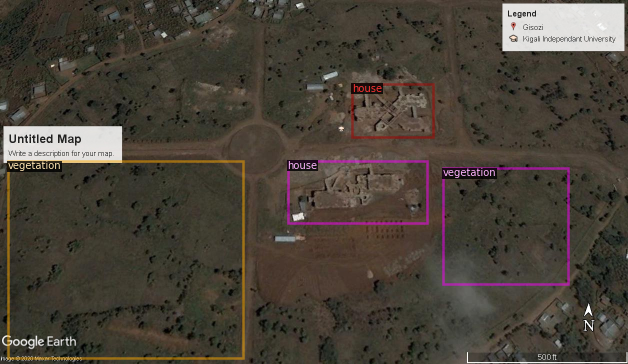

visualizing  ./dataset/DATA/IMAGES/CMU-6-28-2015.jpg


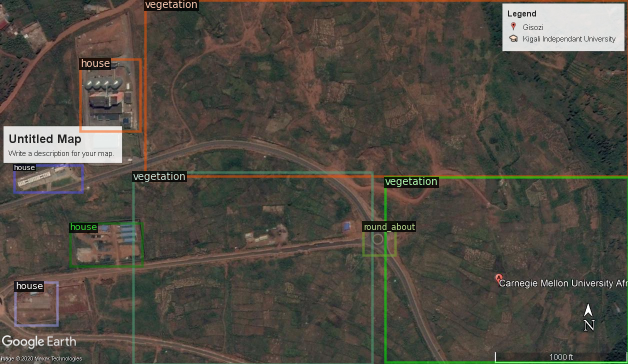

visualizing  ./dataset/DATA/IMAGES/5-17-2016.jpg


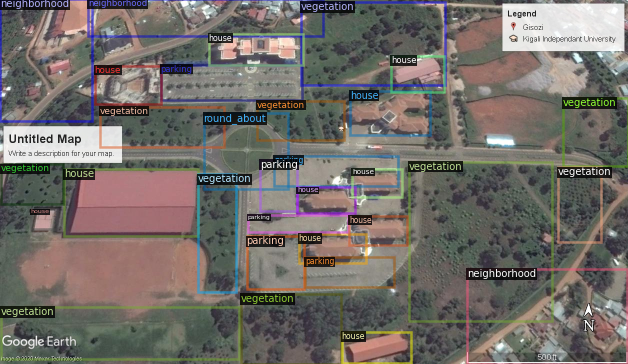

visualizing  ./dataset/DATA/IMAGES/CMU-8-4-2018.jpg


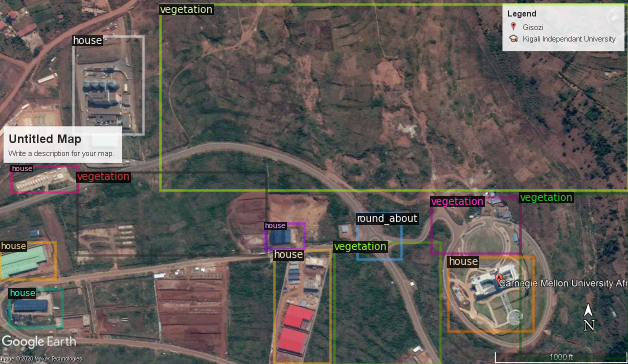

visualizing  ./dataset/DATA/IMAGES/CMU-12-14-2019.jpg


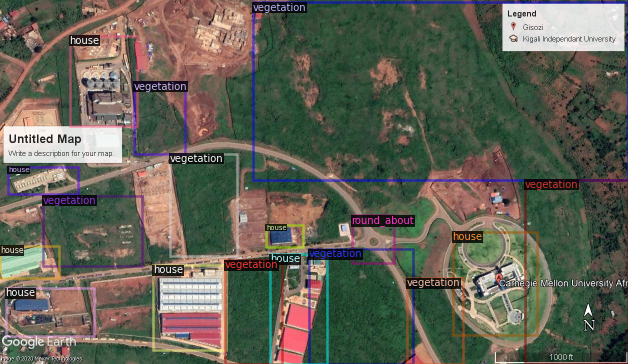

visualizing  ./dataset/DATA/IMAGES/6-30-2012.jpg


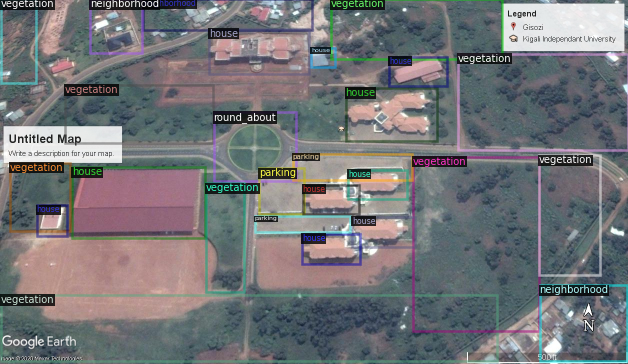

visualizing  ./dataset/DATA/IMAGES/1-14-2014.jpg


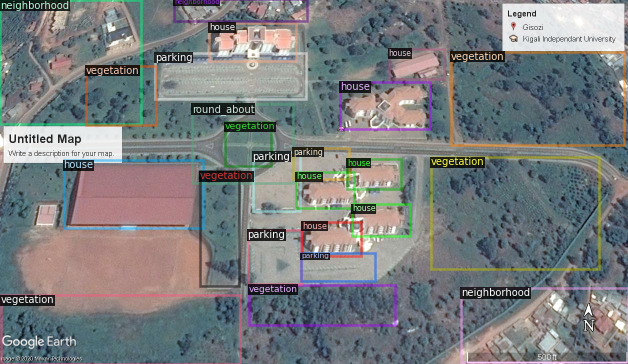

In [ ]:
images_index = [0,1,2,3,4,5,6,7,8]
for index in images_index:
    img = cv2.imread(train_dataset_dicts[index]["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=train_metadata, scale=0.5)
    vis = visualizer.draw_dataset_dict(train_dataset_dicts[index])
    print('visualizing ',train_dataset_dicts[index]["file_name"])
    cv2_imshow(vis.get_image()[:, :, ::-1])

In [ ]:
def rcnn_R_50(init_weights_flag = True, path = '/COCO_init_model'):

      cfg = get_cfg()
      cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/faster_rcnn_R_50_FPN_3x.yaml"))
      cfg.DATASETS.TRAIN = ("train_data",)
      cfg.DATASETS.TEST = ()
      cfg.DATALOADER.NUM_WORKERS = 2
      cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-Detection/faster_rcnn_R_50_FPN_3x.yaml")
      cfg.SOLVER.IMS_PER_BATCH = 8 # images per batch
      cfg.SOLVER.BASE_LR = 0.02  # Learning rate
      cfg.SOLVER.MAX_ITER = 200    # number of iterations 
      cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 128 #regions per batch
      cfg.MODEL.ROI_HEADS.NUM_CLASSES = 15  #three classes
      cfg.with_coco_init = init_weights_flag # Flag to initialize weight to COCO or IMAGENET

      #create a path where I will store my model, this path defers for each model
      os.makedirs(path, exist_ok=True)
      cfg.OUTPUT_DIR = path
      trainer = DefaultTrainer(cfg) 
      trainer.resume_or_load(resume=False)
      trainer.train()

      ## After training lets return the predictor
      cfg.MODEL.WEIGHTS = os.path.join(path, "model_final.pth")
      cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.7   # set the testing threshold for this model
      cfg.DATASETS.TEST = ("valid_data", )

      return DefaultPredictor(cfg),cfg,trainer

In [ ]:
coco_init_predictor, coco_init_cfg, coco_init_trainer = rcnn_R_50()

[11/05 00:09:36 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

model_final_280758.pkl: 167MB [00:08, 20.2MB/s]                           
Skip loading parameter 'roi_heads.box_predictor.cls_score.weight' to the model due to incompatible shapes: (81, 1024) in the checkpoint but (16, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.cls_score.bias' to the model due to incompatible shapes: (81,) in the checkpoint but (16,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.weight' to the model due to incompatible shapes: (320, 1024) in the checkpoint but (60, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.bias' to the model due to incompatible shapes: (320,) in the checkpoint but (60,) in the model! You might want to double check if this is expected.


[11/05 00:09:50 d2.engine.train_loop]: Starting training from iteration 0
[11/05 00:10:30 d2.utils.events]:  eta: 0:06:06  iter: 19  total_loss: 3.303  loss_cls: 2.182  loss_box_reg: 0.776  loss_rpn_cls: 0.223  loss_rpn_loc: 0.195  time: 2.0149  data_time: 0.2754  lr: 0.000400  max_mem: 9434M
[11/05 00:11:12 d2.utils.events]:  eta: 0:05:33  iter: 39  total_loss: 2.048  loss_cls: 0.939  loss_box_reg: 0.838  loss_rpn_cls: 0.098  loss_rpn_loc: 0.169  time: 2.0734  data_time: 0.2586  lr: 0.000799  max_mem: 9434M
[11/05 00:11:58 d2.utils.events]:  eta: 0:05:01  iter: 59  total_loss: 1.709  loss_cls: 0.700  loss_box_reg: 0.813  loss_rpn_cls: 0.061  loss_rpn_loc: 0.148  time: 2.1379  data_time: 0.2586  lr: 0.001199  max_mem: 9434M
[11/05 00:12:42 d2.utils.events]:  eta: 0:04:25  iter: 79  total_loss: 1.451  loss_cls: 0.546  loss_box_reg: 0.741  loss_rpn_cls: 0.051  loss_rpn_loc: 0.132  time: 2.1587  data_time: 0.2569  lr: 0.001598  max_mem: 9434M
[11/05 00:13:26 d2.utils.events]:  eta: 0:03:4

In [ ]:

from google.colab.patches import cv2_imshow
for d in valid_dataset_dicts:
  img = cv2.imread(d["file_name"])
  prediction = coco_init_predictor(img)
  visualizer = Visualizer(img[:, :, ::-1],
                                metadata=valid_metadata,
                                scale=0.5)
  vis = visualizer.draw_instance_predictions(prediction["instances"].to("cpu"))
  cv2_imshow( vis.get_image()[:, :, ::-1])

In [ ]:
evaluator = COCOEvaluator("valid_data", coco_init_cfg, False, output_dir="./dataset")
val_loader = build_detection_test_loader(coco_init_cfg, "valid_data")
inference_on_dataset(coco_init_trainer.model, val_loader, evaluator)

WARNING [11/05 00:18:00 d2.evaluation.coco_evaluation]: json_file was not found in MetaDataCatalog for 'valid_data'. Trying to convert it to COCO format ...
[11/05 00:18:00 d2.data.datasets.coco]: Converting annotations of dataset 'valid_data' to COCO format ...)
[11/05 00:18:00 d2.data.datasets.coco]: Converting dataset dicts into COCO format
[11/05 00:18:00 d2.data.datasets.coco]: Conversion finished, num images: 22, num annotations: 485
[11/05 00:18:00 d2.data.datasets.coco]: Caching COCO format annotations at './dataset/valid_data_coco_format.json' ...
[11/05 00:18:00 d2.data.common]: Serializing 22 elements to byte tensors and concatenating them all ...
[11/05 00:18:00 d2.data.common]: Serialized dataset takes 0.03 MiB
[11/05 00:18:00 d2.evaluation.evaluator]: Start inference on 22 images
[11/05 00:18:01 d2.evaluation.evaluator]: Inference done 11/22. 0.1204 s / img. ETA=0:00:01
[11/05 00:18:03 d2.evaluation.evaluator]: Total inference time: 0:00:02.160245 (0.127073 s / img per de

OrderedDict([('bbox',
              {'AP': 68.0461139309694,
               'AP-house': 75.3846419645534,
               'AP-neighborhood': 67.66779318520119,
               'AP-parking': 60.378171976352405,
               'AP-round_about': 69.44651596959784,
               'AP-vegetation': 67.35344655914217,
               'AP50': 97.3622574268832,
               'AP75': 84.05878862122054,
               'APl': 68.35823212631303,
               'APm': 57.49874394045605,
               'APs': 69.99999999999999})])

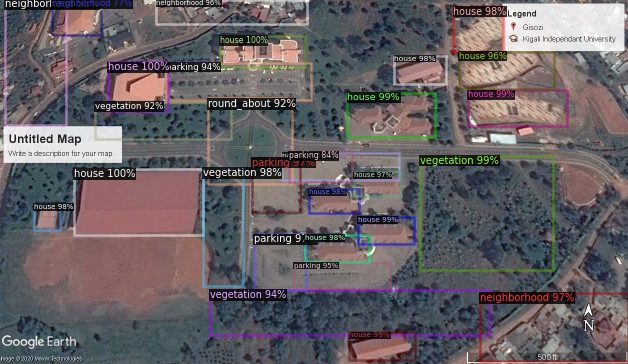

In [ ]:
img = cv2.imread('./dataset/DATA/IMAGES/1-15-2017.jpg')
prediction = coco_init_predictor(img)
visualizer = Visualizer(img[:, :, ::-1],
                              metadata=valid_metadata,
                              scale=0.5)
vis = visualizer.draw_instance_predictions(prediction["instances"].to("cpu"))
cv2_imshow( vis.get_image()[:, :, ::-1])

In [ ]:
#prediction['instances']

In [ ]:
image_list = [
 '2-26-2006.jpg',
    
 '7-7-2010.jpg',
 '6-21-2011.jpg',
 

 '6-30-2012.jpg',
 
 '7-3-2013.jpg',
 
 '1-14-2014.jpg',
 
 '6-7-2015.jpg',
 '9-21-2015.jpg',
 
 '5-17-2016.jpg',
 
 '1-15-2017.jpg',
 '7-14-2017.jpg',
 '12-23-2017.jpg',
    
 '8-4-2018.jpg',
    
 '2-26-2019.jpg',
 '12-14-2019.jpg',
    
 '10-7-2020.jpg',
]


classes = ['house',
'round_about',
'parking',
'vegetation',
'neighborhood']


def visualizeOutputs(img,prediction):
  visualizer = Visualizer(img[:, :, ::-1],
                              metadata=valid_metadata,
                              scale=0.5)
  vis = visualizer.draw_instance_predictions(prediction["instances"].to("cpu"))
  cv2_imshow( vis.get_image()[:, :, ::-1])

def compare(dict1, dict2):
  k1 = [t for t in dict1.keys()]#list(dict1)
  k2 = [g for g in dict2.keys()]#list(dict2)
  
  k = set(k1 + k2)
  out = {}
  for ky_ in k:
    out[ky_] = 0

  for ky in k:
    if ky in k2:
      out[ky] += dict2[ky]
    if ky in k1:
      out[ky] -= dict1[ky]
  return out


def toDict(prediction):
  out = {}
  for ins in prediction['instances'].pred_classes:
    if classes[ins] not in out.keys():
      out[classes[ins]] = 1
    else:out[classes[ins]] += 1
  return out

def compateTimeSeriesImages(im1,im2):
  image1 = cv2.imread('./dataset/DATA/IMAGES/'+im1)
  image2 = cv2.imread('./dataset/DATA/IMAGES/'+im2)
  prediction1 = coco_init_predictor(image1)
  visualizeOutputs(image1,prediction1)
  prediction2 = coco_init_predictor(image2)
  visualizeOutputs(image2,prediction2)
  out1 = toDict(prediction1)
  out2 = toDict(prediction2)
  changes = compare(out1, out2)
  return changes


In [ ]:

def testProject():
  for i in range(len(image_list)-1):
    im1 = image_list[i]
    im2 = image_list[i+1]
    print('\n COMPARING IMAGE ',im1,' AND ',im2 ,'\n')
    print(compateTimeSeriesImages(im1,im2))
    print('\n'*5)
    #print(im1,im2)



 COMPARING IMAGE  2-26-2006.jpg  AND  7-7-2010.jpg 



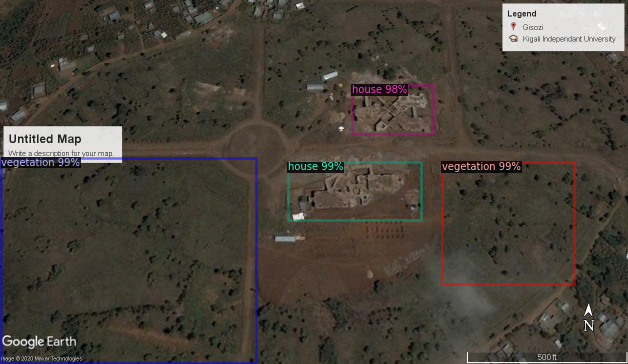

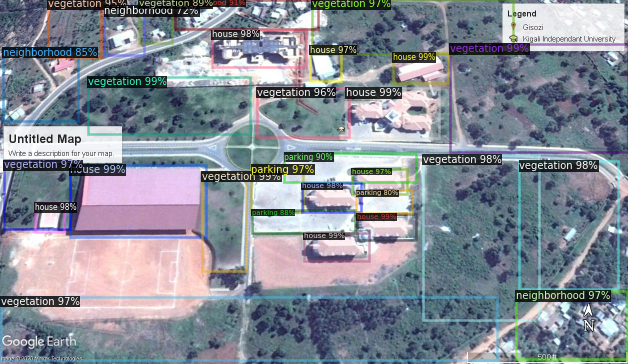

{'neighborhood': 4, 'vegetation': 9, 'parking': 4, 'house': 8}







 COMPARING IMAGE  7-7-2010.jpg  AND  6-21-2011.jpg 



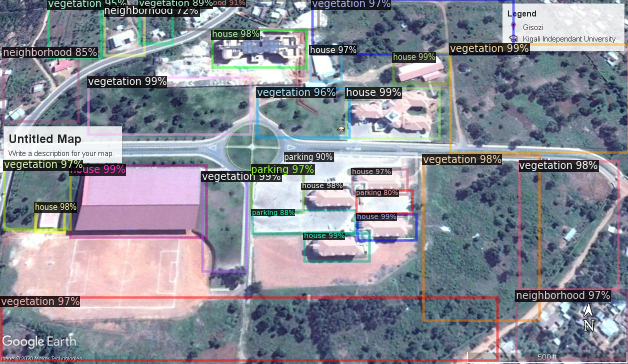

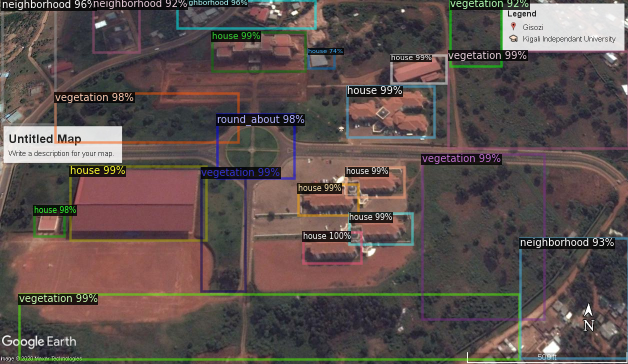

{'round_about': 1, 'neighborhood': 0, 'vegetation': -5, 'parking': -4, 'house': 0}







 COMPARING IMAGE  6-21-2011.jpg  AND  6-30-2012.jpg 



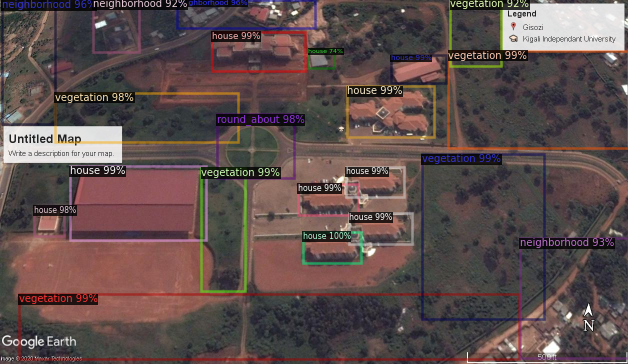

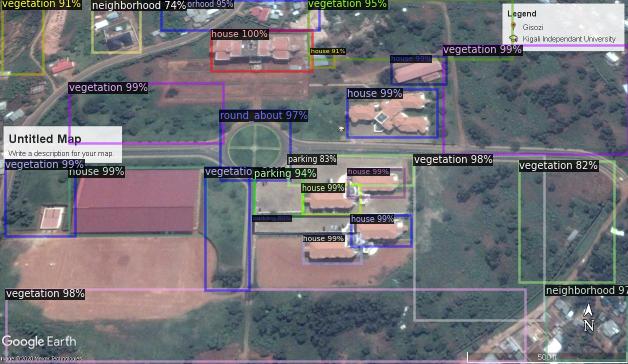

{'round_about': 0, 'neighborhood': -1, 'vegetation': 3, 'parking': 3, 'house': -1}







 COMPARING IMAGE  6-30-2012.jpg  AND  7-3-2013.jpg 



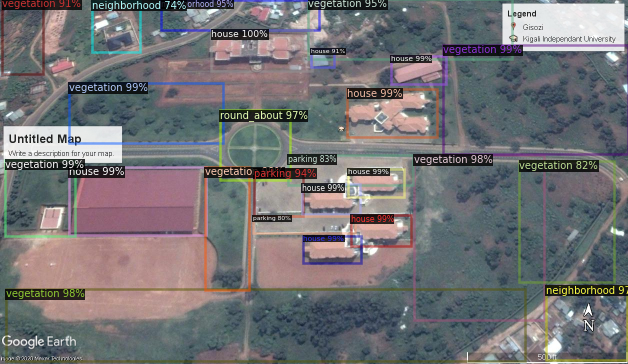

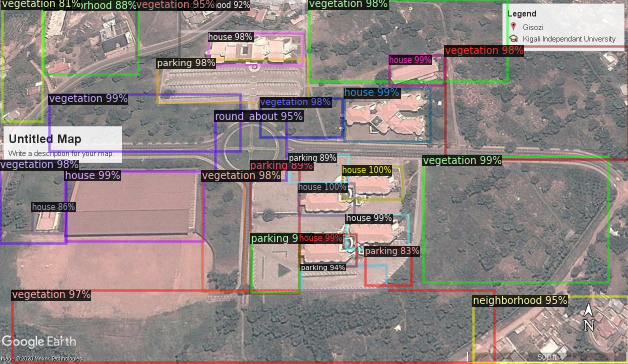

{'round_about': 0, 'neighborhood': 0, 'vegetation': 1, 'parking': 3, 'house': 0}







 COMPARING IMAGE  7-3-2013.jpg  AND  1-14-2014.jpg 



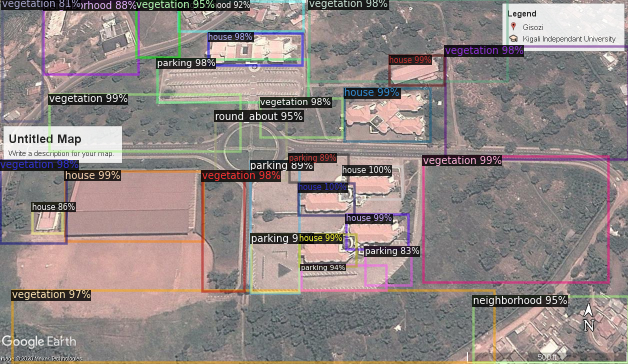

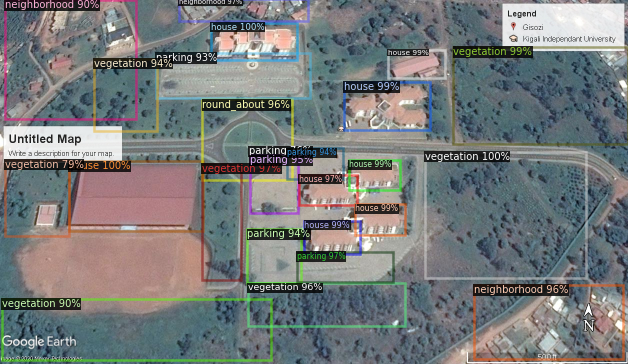

{'round_about': 0, 'neighborhood': 0, 'vegetation': -3, 'parking': 0, 'house': -1}







 COMPARING IMAGE  1-14-2014.jpg  AND  6-7-2015.jpg 



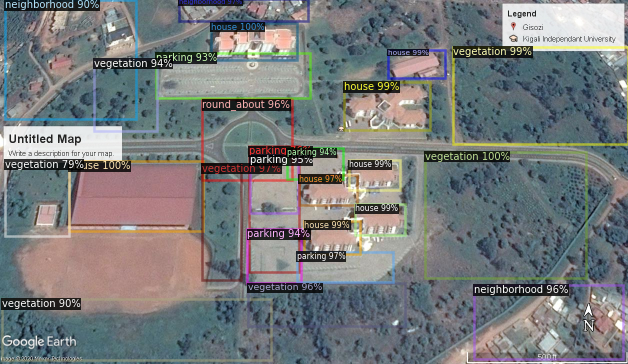

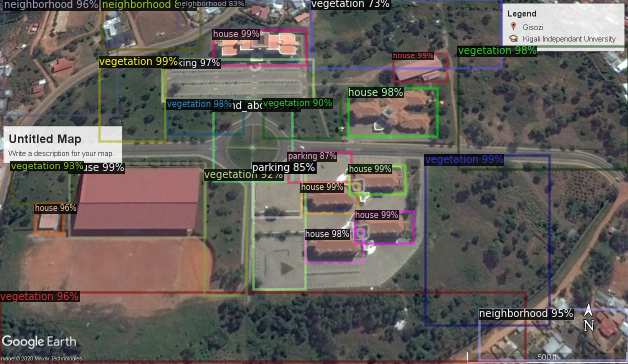

{'round_about': 0, 'neighborhood': 1, 'vegetation': 2, 'parking': -2, 'house': 1}







 COMPARING IMAGE  6-7-2015.jpg  AND  9-21-2015.jpg 



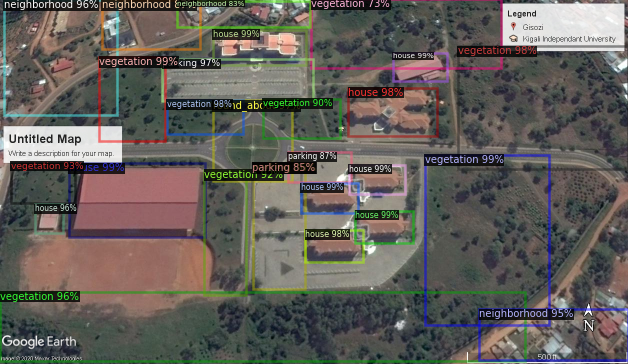

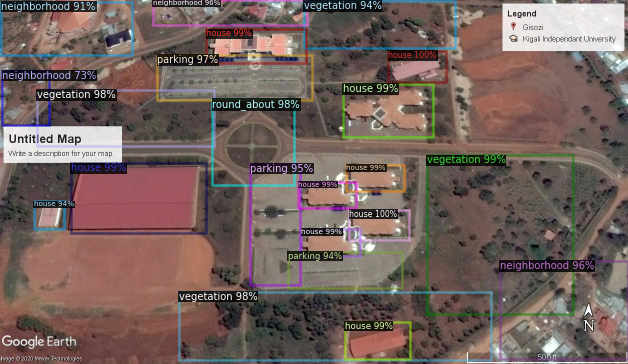

{'round_about': 0, 'neighborhood': 0, 'vegetation': -5, 'parking': -1, 'house': 1}







 COMPARING IMAGE  9-21-2015.jpg  AND  5-17-2016.jpg 



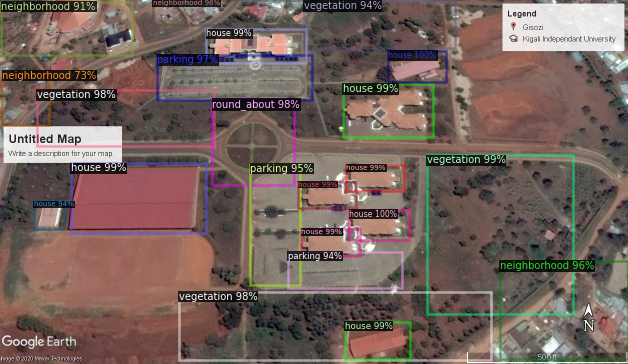

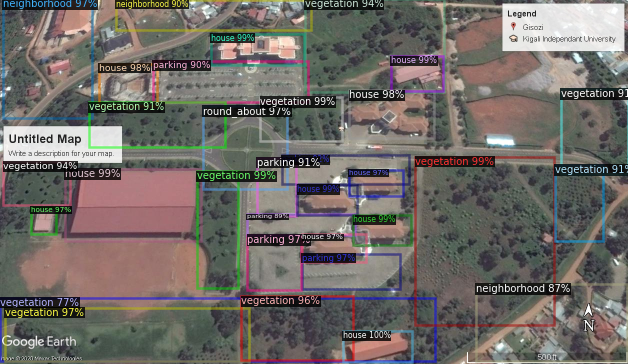

{'round_about': 0, 'neighborhood': -1, 'vegetation': 7, 'parking': 3, 'house': 1}







 COMPARING IMAGE  5-17-2016.jpg  AND  1-15-2017.jpg 



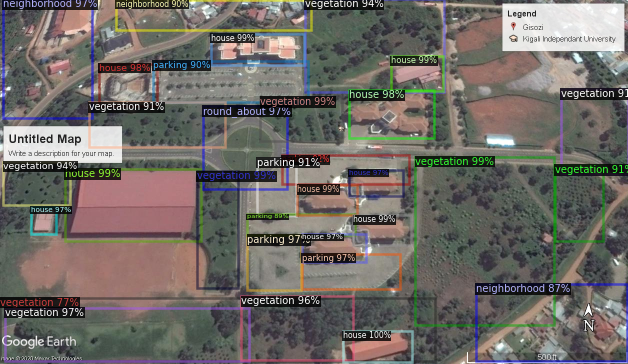

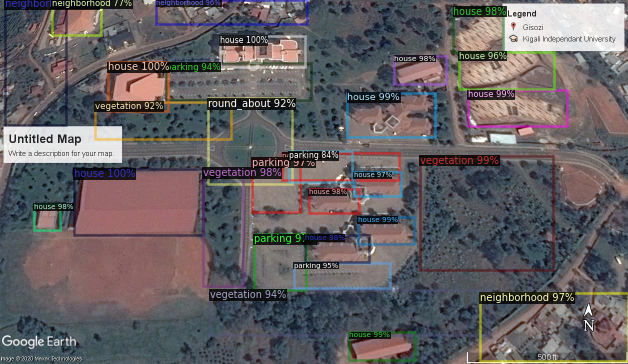

{'round_about': 0, 'neighborhood': 1, 'vegetation': -7, 'parking': 0, 'house': 3}







 COMPARING IMAGE  1-15-2017.jpg  AND  7-14-2017.jpg 



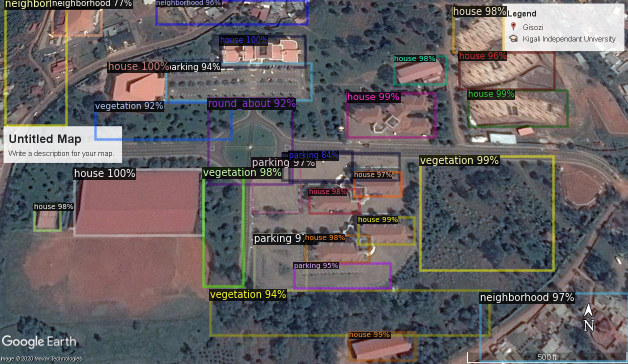

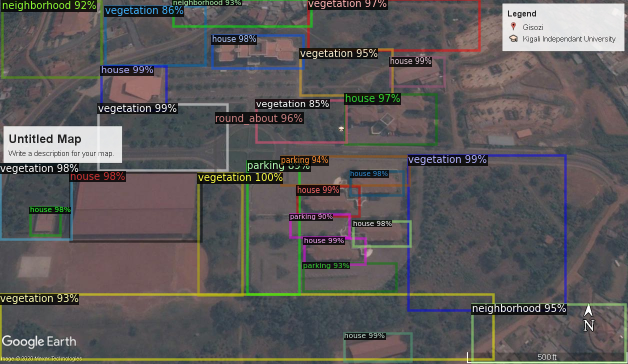

{'round_about': 0, 'neighborhood': -1, 'vegetation': 5, 'parking': -2, 'house': -3}







 COMPARING IMAGE  7-14-2017.jpg  AND  12-23-2017.jpg 



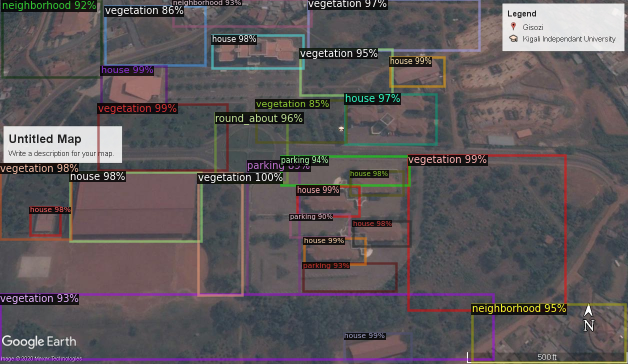

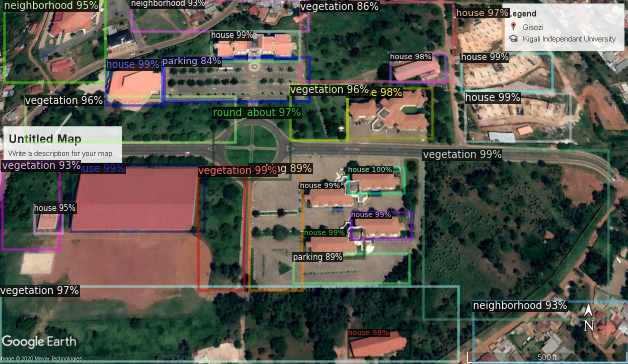

{'round_about': 0, 'neighborhood': 0, 'vegetation': -2, 'parking': -1, 'house': 3}







 COMPARING IMAGE  12-23-2017.jpg  AND  8-4-2018.jpg 



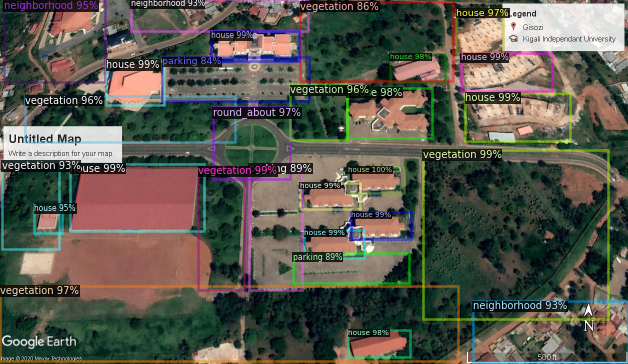

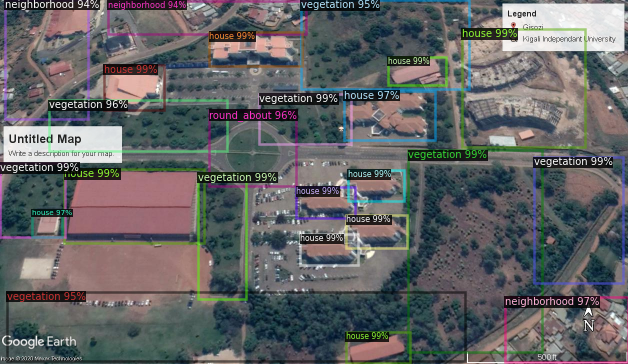

{'round_about': 0, 'neighborhood': 0, 'vegetation': 1, 'parking': -3, 'house': -2}







 COMPARING IMAGE  8-4-2018.jpg  AND  2-26-2019.jpg 



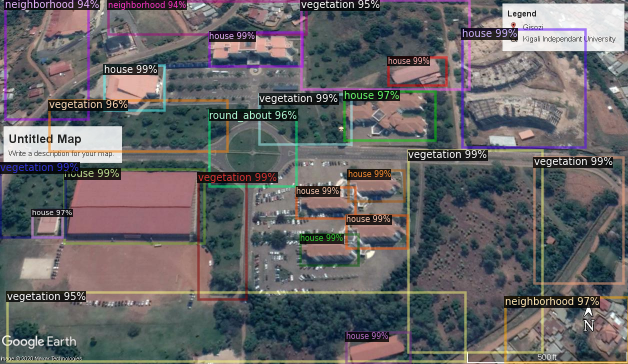

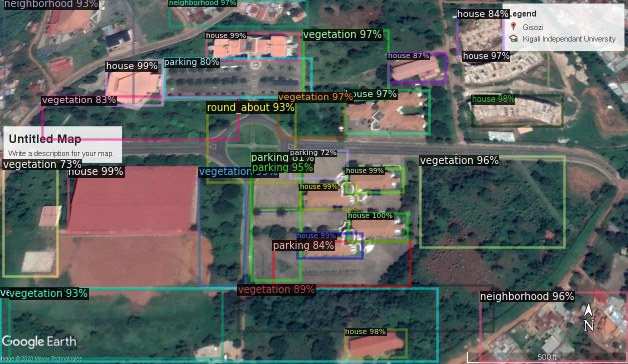

{'round_about': 0, 'neighborhood': 0, 'vegetation': 1, 'parking': 5, 'house': 1}







 COMPARING IMAGE  2-26-2019.jpg  AND  12-14-2019.jpg 



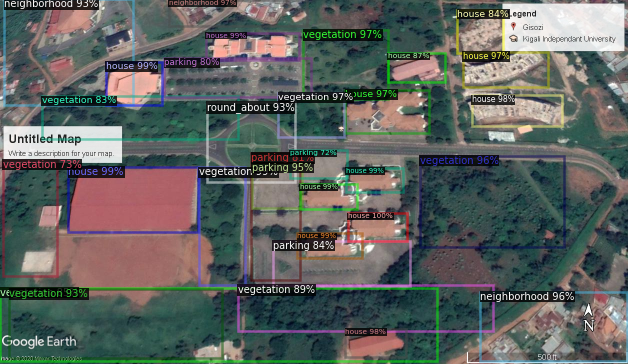

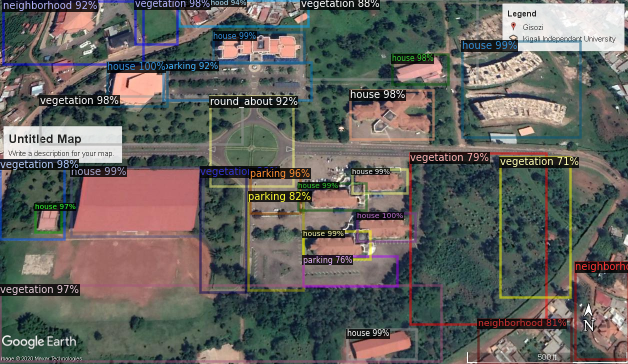

{'round_about': 0, 'neighborhood': 1, 'vegetation': -1, 'parking': -1, 'house': -1}







 COMPARING IMAGE  12-14-2019.jpg  AND  10-7-2020.jpg 



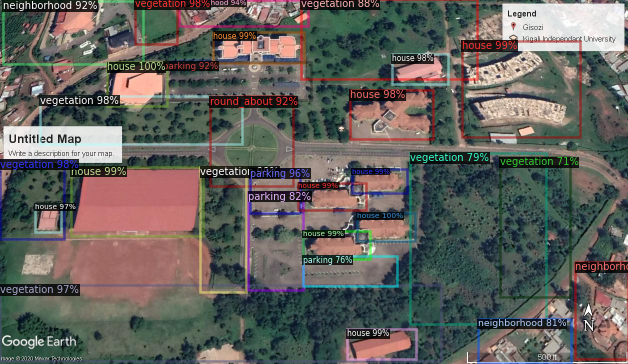

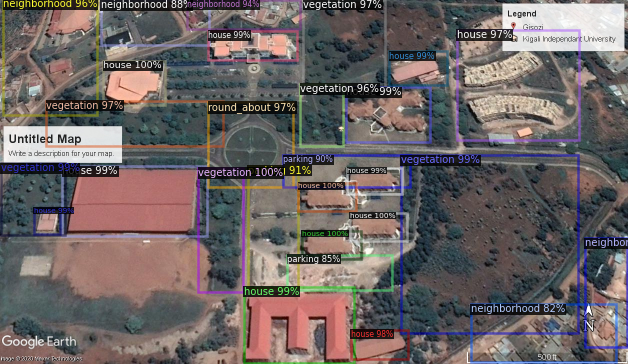

{'round_about': 0, 'neighborhood': 1, 'vegetation': -2, 'parking': -1, 'house': 1}








In [ ]:
testProject()

In [ ]:
import pandas as pd
pd.DataFrame(data,index=[1])

,neighborhood,vegetation,parking,house
1,4,9,4,8
